In [1]:
from __future__ import print_function, absolute_import
from os import path
import numpy as np
import matplotlib.pyplot as plt
import scipy.io as sio
from scipy import signal, fft


## The data

The data is synthetic data that aims to recreate thalamic LFP.
It has background activity, with two distinct events:
    
    1. Spindles
    
    2. K-complexes

The idea is to separate these events while also obtaining the dynamics of the trasitions.

In [2]:
root_folder = './data/synthetic'
data_file = 'ts1.mat'
data_path = path.join(root_folder, data_file)
data = sio.loadmat(data_path)
Vp=np.squeeze(data['Vp'])
Vp = Vp - np.mean(Vp)

## Plotting the timeseries

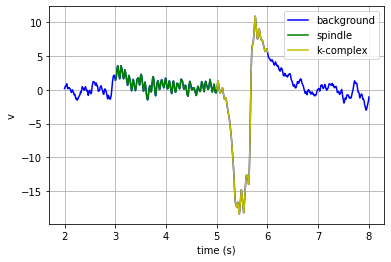

In [3]:
plt.plot(np.linspace(2, 8, 6000), Vp[2000:8000], 'b', label='background');
plt.xlabel('time (s)');
plt.ylabel('v');
plt.grid();

plt.plot(np.linspace(3,5,2000), Vp[3000:5000], 'g', label='spindle');
plt.plot(np.linspace(5,6,1000), Vp[5000:6000], 'y', label='k-complex');
plt.legend();

## STFT

In [56]:
nperseg=1024
noverlap = nperseg//2
f, t, data_stft = signal.stft(
    Vp, fs=1000, nperseg=nperseg, noverlap=noverlap, axis=1)
data_stft = np.abs(np.squeeze(data_stft[:,5:])) 
data_stft[:,0] = 0
t = t[5:]


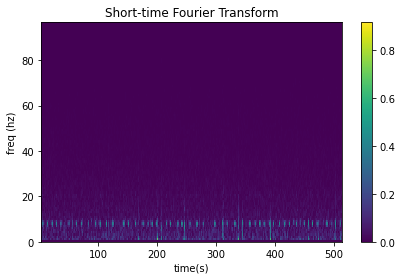

In [57]:
plt.pcolormesh(t[:1000], f[:100], data_stft[:1000,:100].T)
plt.title("Short-time Fourier Transform")
plt.xlabel('time(s)')
plt.ylabel('freq (hz)')
plt.colorbar()
plt.tight_layout()

# SVD based decomposition

## Normalizing the STFT

In [58]:
from sklearn.preprocessing import normalize

In [59]:
data_stft_norm = normalize(data_stft.copy(), axis=1, norm='l1')
mean_p = np.mean(data_stft, 0)
data_stft_norm = data_stft - mean_p

# SVD

In [60]:
u, s, vh = np.linalg.svd(data_stft_norm.T, full_matrices=False)

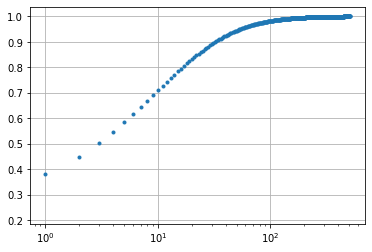

In [61]:
# Singular values
plt.semilogx(np.cumsum(s)/sum(s), '.');
plt.grid()

In [62]:
# Find index where cumulative-sum of sigmas >= 0.9
maj_sigs = np.where(np.cumsum(s)/sum(s) >= 0.9)
maj_sigs[0][0]

33

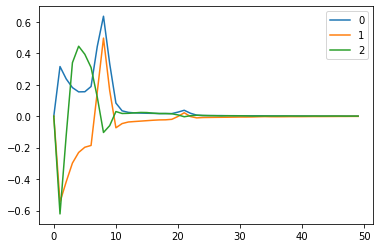

In [63]:
# Look at the first 10 basis vectors
for i in range(3):
    plt.plot(u[:50, i], label="{}".format(i))
plt.legend()

In [64]:
ncomps = 50
data_appr = u[:, :ncomps] @ np.diag(s[:ncomps]) @ vh[:ncomps, :]

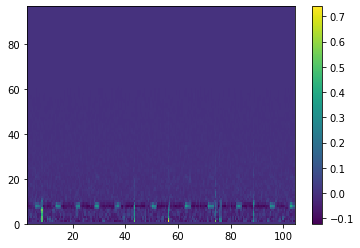

In [65]:
# Approximate the data matrix with rank 50
plt.pcolormesh(t[:200], f[:100], data_appr[:100, :200])
# plt.clim([-5, 5])
plt.colorbar()

# HMM

In [66]:
from hmmlearn import hmm

%time model=hmm.GaussianHMM(n_components=5, covariance_type="diag", n_iter=1000).fit(data_appr[:50, :].T)

preds = model.predict(data_appr[:50, :].T)

plt.subplot(2,1,1)
plt.pcolormesh(data_stft.T[:30, :200])
plt.subplot(2,1,2)
plt.plot(np.linspace(0.5,200.5, 200), preds[0:200])
plt.xlim([0,200])
plt.grid()

# Find relative counts of each state
states, counts = np.unique(preds, return_counts=True)
counts = counts/sum(counts)

plt.plot(states, counts)


# Plot the spectrum of each state - sorted in decreasing order of state-frequency

idx = np.argsort(counts)

plt.plot(mean_p[:50], 'k', label='Mean PSD')
for i in idx[::-1]:
    plt.plot(model.means_[i]+mean_p[:50], label="state {}".format(i))
plt.legend()
plt.grid()

# Get the mean PSD for each state

means = np.zeros((6, 50))
for i in range(means.shape[0]-1):
    means[i,:] = model.means_[i]
means[5,:] = mean_p[:50]

means = normalize(means, axis=1, norm='l2')

# Find similarity of one state with another.

dots = np.zeros((5,5))
dots[:] = np.nan
for i in range(5):
    for j in range(i):
            dots[i,j] = model.means_[i]/np.sqrt(np.sum([n**2 for n in model.means_[i]])) @ model.means_[j]/np.sqrt(np.sum([n**2 for n in model.means_[j]]))
plt.imshow(np.abs(dots))
plt.clim([0,1])
plt.colorbar()

## Using vh (V') for fitting HMM

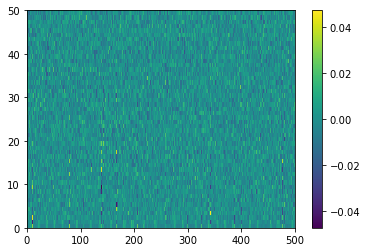

In [75]:
plt.pcolormesh(vh[:50, :500])
plt.colorbar()

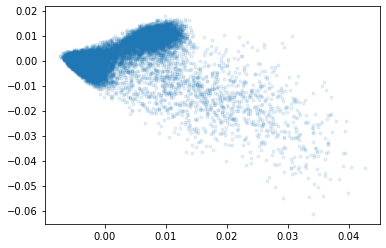

In [68]:
plt.plot(vh[0,:], vh[1,:], '.', alpha=0.1)

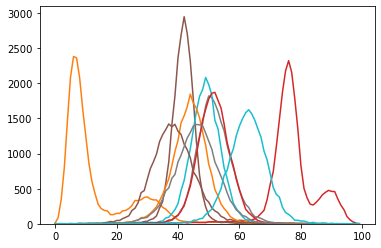

In [69]:
for i in range(10):
    x0 = plt.hist(vh[i,:], 100, alpha=0.3)
    plt.plot(x0[0])


In [70]:
ncomps=20
nstates=5

%time model=hmm.GaussianHMM(n_components=5, covariance_type="diag", n_iter=1000).fit(vh[:ncomps, :].T)
preds = model.predict(vh[:ncomps, :].T)



CPU times: user 17.2 s, sys: 1.39 s, total: 18.6 s
Wall time: 3.66 s


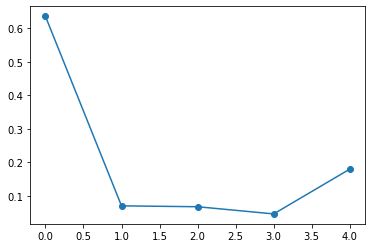

In [71]:
states, counts = np.unique(preds, return_counts=True)
counts = counts/sum(counts)

plt.plot([i for i in states], counts, 'o-')

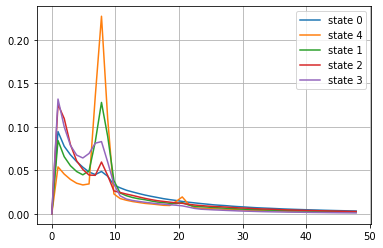

In [72]:
idx = np.argsort(counts)

means = np.zeros((len(idx), 50))
for i in range(means.shape[0]):
    p = u[:,:ncomps] @ np.diag(s[:ncomps]) @ model.means_[i]
    means[i,:] = p[:50] + mean_p[:50]
    means[i,:] = means[i,:]/np.sum(means[i,:])

for i in idx[::-1]:
    plt.plot(f[:50], means[i,:], label="state {}".format(i))
plt.legend()
plt.grid()

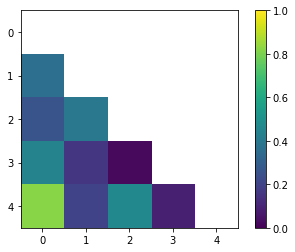

In [73]:
dots = np.zeros((5,5))
dots[:] = np.nan
for i in range(5):
    for j in range(i):
            dots[i,j] = (model.means_[j].T)/np.sqrt(np.sum([n**2 for n in model.means_[j]])) @ model.means_[i]/np.sqrt(np.sum([n**2 for n in model.means_[i]]))
plt.imshow(np.abs(dots))
plt.clim([0,1])
plt.colorbar()

In [74]:
dots

array([[        nan,         nan,         nan,         nan,         nan],
       [-0.36659905,         nan,         nan,         nan,         nan],
       [ 0.25921463, -0.40061105,         nan,         nan,         nan],
       [-0.44839463,  0.15767479,  0.02627079,         nan,         nan],
       [-0.82104791,  0.19965952, -0.46612882, -0.08621498,         nan]])

# Using Bayesian GMM models

In [106]:
from sklearn.mixture import BayesianGaussianMixture

gm = BayesianGaussianMixture(n_components=20, covariance_type="diag", max_iter=1000)

In [107]:
ncomps= 15
%time gm.fit(vh[:15, :].T)

CPU times: user 33.7 s, sys: 2.61 s, total: 36.3 s
Wall time: 7.03 s


BayesianGaussianMixture(covariance_type='diag', max_iter=1000, n_components=20)

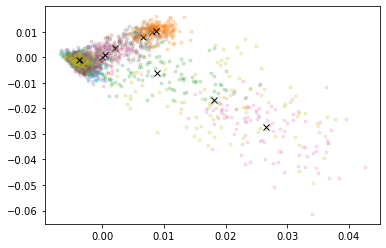

In [109]:
for i in idx[::-1]:
    plt.plot(vh[0,pred==i][:100], vh[1,pred==i][:100], '.', alpha=0.2)
    plt.plot(gm.means_[i][0], gm.means_[i][1], 'kx')

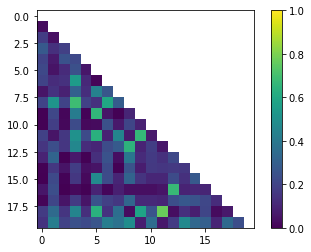

In [114]:
dots = np.zeros((len(gm.means_),len(gm.means_)))
dots[:] = np.nan
for i in range(len(gm.means_)):
    for j in range(i):
            dots[i,j] = (gm.means_[j].T)/np.sqrt(np.sum([n**2 for n in gm.means_[j]])) @ gm.means_[i]/np.sqrt(np.sum([n**2 for n in gm.means_[i]]))
plt.imshow(np.abs(dots))
plt.clim([0,1])
plt.colorbar()

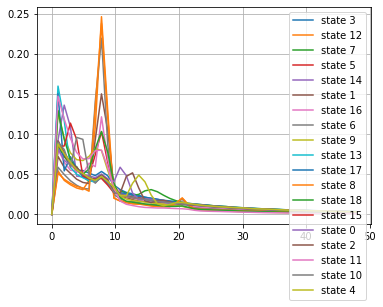

In [112]:
pred = gm.predict(vh[:15,:].T)
states, counts = np.unique(pred, return_counts=True)
counts = counts/np.sum(counts)

idx = np.argsort(counts)

means = np.zeros((len(idx), 50))
for i in range(means.shape[0]):
    p = u[:,:ncomps] @ np.diag(s[:ncomps]) @ gm.means_[i]
    means[i,:] = p[:50] + mean_p[:50]
    means[i,:] = means[i,:]/np.sum(means[i,:])

for i in idx[::-1]:
    plt.plot(f[:50], means[i,:], label="state {}".format(i))
plt.legend()
plt.grid()